In [4]:
import numpy as np
import scipy as sp
from scipy.optimize import minimize
from numpy import random, linalg
from matplotlib import cm
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from numpy import random, linalg

# HOMOTOPIES

In [158]:
def linear_homotopy (f, g, t):
    def lin(x):
        return t*f(x) + (1.0-t)*g(x)
    return lin


def square_homotopy (f, g, t):
    def sqr(x):
        return t**2*f(x) + (1.0-t)**2*g(x)
    return sqr

def quad_homotopy (f, g, t):
    def sqr(x):
        return t**4*f(x) + (1.0-t)**4*g(x)
    return sqr

def root_homotopy (f, g, t):
    def root(x):
        return t**0.5*f(x) + (1.0-t)**0.5*g(x)
    return root

def cube_homotopy (f, g, t):
    def root(x):
        return (0.5*(-1 + 2*t)**3 + 0.5)*f(x) + (1.0-(0.5*(-1 + 2*t)**3 + 0.5))*g(x)
    return root


def random_ball(num_points, dimension, radius=1):

    # First generate random directions by normalizing the length of a
    # vector of random-normal values (these distribute evenly on ball).
    random_directions = random.normal(size=(dimension,num_points))
    random_directions /= linalg.norm(random_directions, axis=0)
    # Second generate a random radius with probability proportional to
    # the surface area of a ball with a given radius.
    random_radii = random.random(num_points) ** (1/dimension)
    # Return the list of random (direction & length) points.
    return radius * (random_directions * random_radii).T

def smooth_homotopy (f, g, t):
    def smooth (x):
        B = random_ball (100, x.size, (1-t)) + x
        res = np.zeros(100)
        for i in range (res.size):
            res [i] = f(B[i])
       # print (res.mean())
        return res.mean()
    return smooth

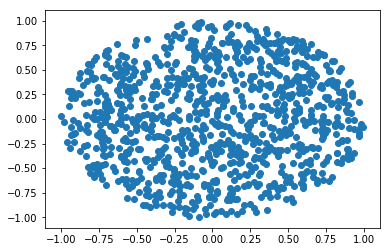

In [6]:
x = random_ball (1000, 2, 1).T
plt.scatter (x[0], x[1])

# HOM & HOPE frameworks

In [7]:
def make_minimize_cb(path=[]):
    
    def minimize_cb(xk):
        # note that we make a deep copy of xk
        path.append(np.copy(xk))

    return minimize_cb

In [137]:
def HOM (f, g, h, init, iter_num, real_min):
    traj = np.zeros((3, iter_num))
    dt = 1.0/iter_num
    tr = [init]
    fig = plt.figure(figsize=plt.figaspect(iter_num*0.5))
    fig.set_size_inches(15, 30)
    for i in range (0, iter_num):
        path = [init]
        H = h(f, g, dt*i)
        if i == iter_num-1:
            H = f
        init = minimize(H, x0=init, method='Powell', tol=1e-10, callback=make_minimize_cb(path)).x
        path = np.array (path)
        path = path.transpose()
        traj[0][i] = i
        tr.append (init)
        #print (path)
        traj[1][i] = path[0].size
        traj[2][i] = linalg.norm (init - real_min)
        ax = fig.add_subplot(iter_num/2, 2, i+1, projection='3d')
        X = np.arange(-4, 4, 0.1)
        Y = np.arange(-4, 4, 0.1)
        Z = np.zeros ((80, 80))
        #print (i*dt, "heh")
        for j in range (X.size):
            for k in range (Y.size):
                Z[j][k] = H(np.array([X[j], Y[k]]))
        X, Y = np.meshgrid(X, Y) 
        ax.plot([init[0]], [init[1]], [H(init)] , markerfacecolor='k', markeredgecolor='k', marker='o', markersize=10, alpha=1, zorder = 1)
        surf = ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap=cm.coolwarm,
                               linewidth=0, antialiased=False, alpha = 0.5, zorder=2)
        

        #ax.set_zlim(-1.01, 1.01)
        fig.colorbar(surf, shrink=0.5, aspect=10)
    plt.show()
    return traj
    

In [126]:
def HOM1D (f, g, h, init, iter_num):
    traj = np.zeros((2, iter_num))
    dt = 1.0/iter_num
    tr = [init]
    fig = plt.figure(figsize=plt.figaspect(iter_num*0.5))
    fig.set_size_inches(15, 30)
    for i in range (0, iter_num):
        path = [init]
        H = h(f, g, i/iter_num)
        if i == iter_num: 
            H = f 
        init = minimize(H, x0=init, method='Powell', tol=1e-10, callback=make_minimize_cb(path)).x
        path = np.array (path)
        path = path.transpose()
        traj[0][i] = i
        tr.append (init)
        print (path)
        traj[1][i] = path[0].size
        ax = fig.add_subplot(iter_num/2, 2, i+1)
        X = np.arange(-20, 20, 0.1)
        #Y = np.arange(-2, 2, 0.1)
        Z = np.zeros((400))
        #print (i*dt, "heh")
        for j in range (X.size):
            Z[j] = H([X[j]])
        ax.plot([init], [H(np.array([init]))] , markerfacecolor='k', markeredgecolor='k', marker='o', markersize=10, alpha=1)
        ax.plot(X, Z)
        

        #ax.set_zlim(-1.01, 1.01)
        #fig.colorbar(surf, shrink=0.5, aspect=10)
    plt.show()
    return traj, tr
    

In [82]:
def HOPE (f, g, h, init, iter_num):
    dt = 1.0/iter_num
    c_max = 100
    b_max = 10
    x_loc = np.zeros ((c_max, init.size))
    x_glob = np.zeros ((b_max, init.size + 1))
    for j in range (b_max):
        x_glob[j][0] = init[0]
        x_glob[j][1] = init[1]
    fig = plt.figure(figsize=plt.figaspect(iter_num*0.5))
    fig.set_size_inches(15, 30)
    for i in range (iter_num):
        H = h(f, g, dt*i)
        path = [init]
        for j in range(b_max):
            x_loc[b_max-1] = minimize(H, x0=(np.array([x_glob[j][0], x_glob[j][1]])), method='Powell', tol=1e-10).x
            for k in range(b_max-1):
                pertrubation = random.normal(size=(init.size))*5
                x_loc[k + j*b_max] = minimize(H, x0=(np.array([x_glob[j][0], x_glob[j][1]]) + pertrubation), method='Powell', tol=1e-10).x
            X = np.zeros((3, c_max))
            X[0] = x_loc.T[0]
            X[1] = x_loc.T[1]
            for j in range(c_max): X[2] = H (np.array([X[0][j], X[1][j]]))
            x_glob.T[0] = X[0][:b_max]
            #print (x_glob.T[0])
            x_glob.T[1] = X[1][:b_max]
            x_glob.T[2] = X[2][:b_max]
            
            #graph
            path = np.array (path)
            path = path.transpose()
            ax = fig.add_subplot(iter_num/2, 2, i+1, projection='3d')
            X = np.arange(-2, 2, 0.1)
            Y = np.arange(-2, 2, 0.1)
            Z = np.zeros ((40, 40))
            
            for l in range (X.size):
                for k in range (Y.size):
                    Z[l][k] = H(np.array([X[l], Y[k]]))
            z = np.zeros((b_max))
            
            for l in range (b_max):
                    z[l] = H(np.array([x_glob[l][0], x_glob[l][1]]))
            X, Y = np.meshgrid(X, Y) 
            ax.scatter(x_glob.T[0], x_glob.T[1], z)
            surf = ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap=cm.coolwarm,
                                   linewidth=0, antialiased=False, alpha = 0.7)
        

        print (x_glob)
        fig.colorbar(surf, shrink=0.5, aspect=10)
            
    X = np.zeros ((2, 10))
    plt.show()
    #x_glob.sort(axis=2)
    return x_glob[0]

# FUNCTIONS TO OPTIMIZE

In [174]:
def sqr (x):
    return np.inner (x, x)

def rose (x):
    return ((1-x[0])**2 + 100*(x[1] - x[0]**2)**2)

def sinnx(x):
    return np.sin (x[0]*100)

def six (x):
    return np.sin(x[0])/x[0]

def easom (x):
    return -np.cos(x[0])*np.cos(x[1])*np.exp(-((x[0]-np.pi)**2+(x[1]-np.pi)**2))

def himmelblau (x):
    return (x[0]**2 + x[1] - 11)**2 + (x[0] + x[1]**2 - 7)**2

def levi (x):
    return np.sin(3*np.pi*x[0])**2 + (x[0] - 1)**2*(1 + np.sin(3*np.pi*x[1])**2) + (x[1] - 1)**2*(1 + np.sin(2*np.pi*x[0])**2)

def cross (x):
        return -0.0001 *(np.absolute(np.sin(x[0])*np.sin(x[1])*np.exp (np.absolute (100 - np.sqrt(linalg.norm(x))/np.pi))) + 1)**0.1

# EXPERIMENTS

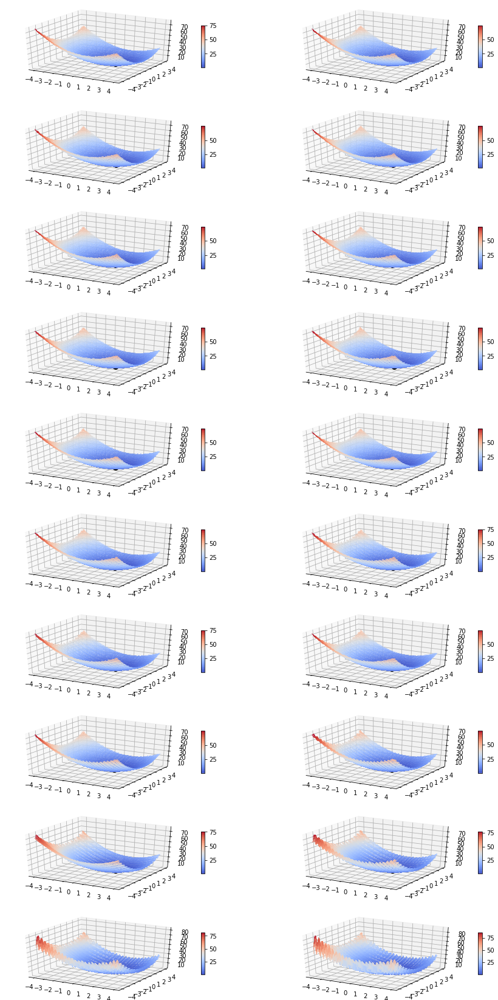

(array([[ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
        13., 14., 15., 16., 17., 18., 19.],
       [ 4.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  4.,  3.,  3.,
         4.,  3.,  3.,  3.,  4.,  3.,  3.]]), [array([0, 0]), array([0.99074138, 1.07312364]), array([0.99247794, 1.14521619]), array([1.05349358, 0.98578093]), array([0.98655008, 1.03792382]), array([0.96229251, 1.09631783]), array([0.96777836, 1.05422728]), array([1.02251998, 0.99224954]), array([1.1578167 , 0.98555034]), array([1.0471713 , 0.93609391]), array([0.92550614, 0.96349707]), array([0.95968062, 1.01087872]), array([1.00627307, 1.01630368]), array([0.97780106, 0.99796816]), array([0.88877073, 1.00483318]), array([0.87858232, 0.99058971]), array([0.86738374, 1.0363093 ]), array([0.96790055, 1.01645169]), array([0.98813241, 0.99590057]), array([0.99552311, 1.04683553]), array([1., 1.])])


In [125]:
print (HOM (levi, sqr, smooth_homotopy, np.array([0, 0]), 20))

# ROSENBROCK

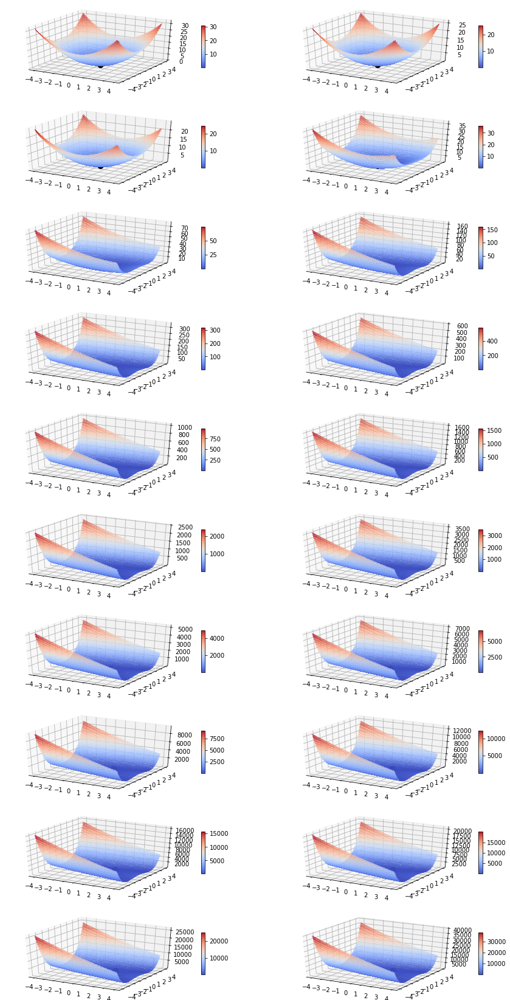

165.0


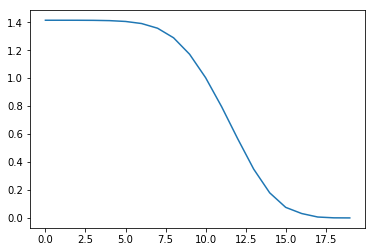

In [141]:
traj = HOM (rose, sqr, quad_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

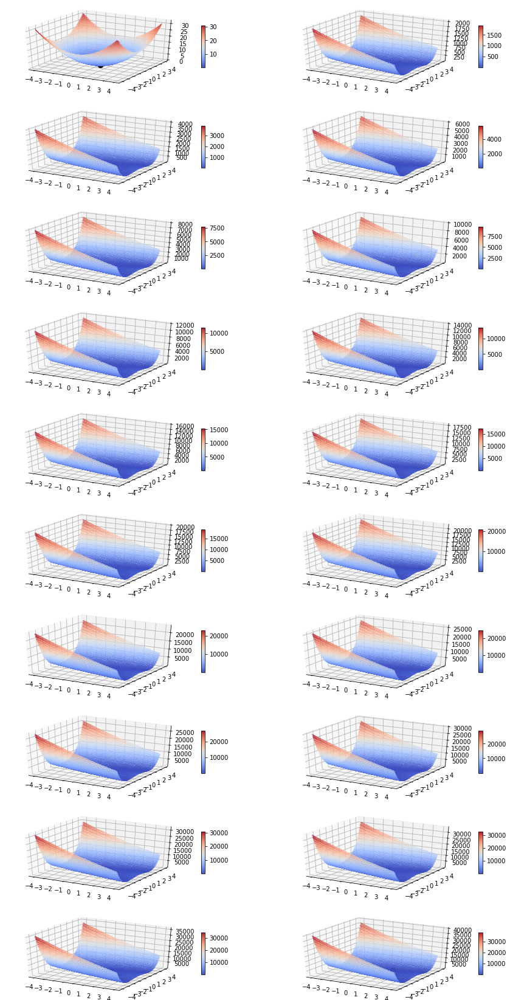

149.0


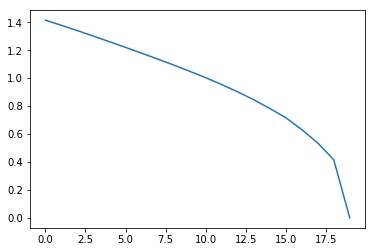

In [142]:
traj = HOM (rose, sqr, linear_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

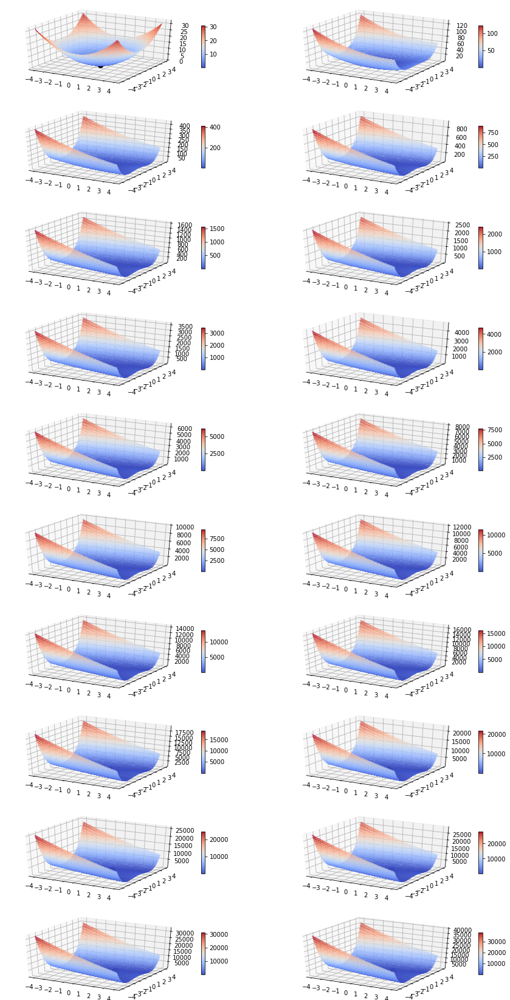

140.0


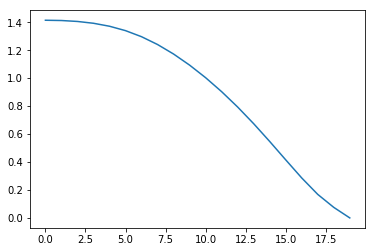

In [144]:
traj = HOM (rose, sqr, square_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

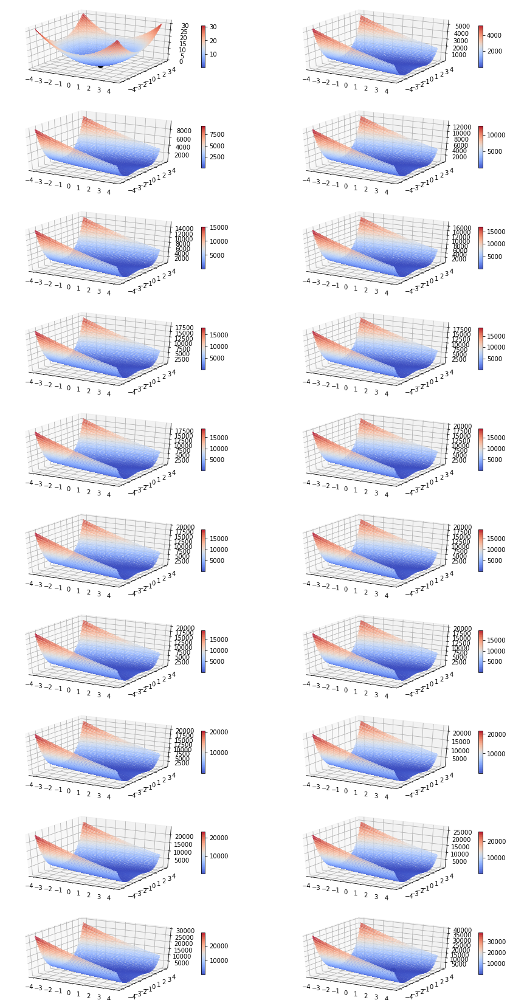

125.0


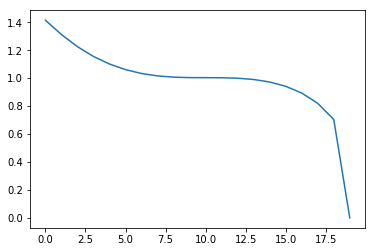

In [146]:
traj = HOM (rose, sqr, cube_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

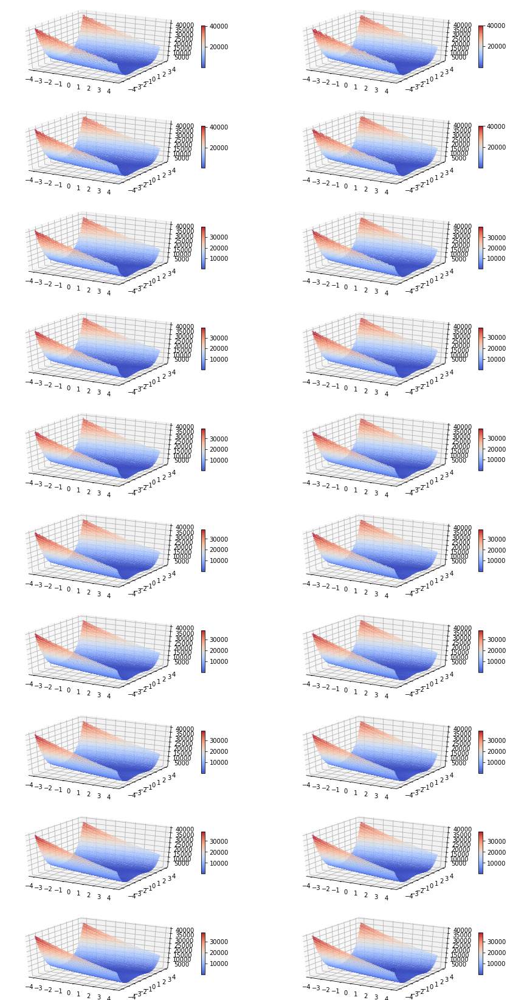

86.0


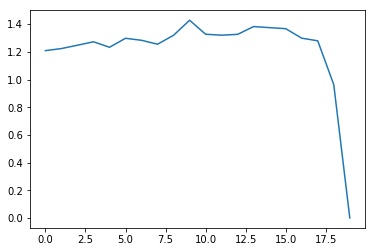

In [147]:
traj = HOM (rose, sqr, smooth_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

# LEVI

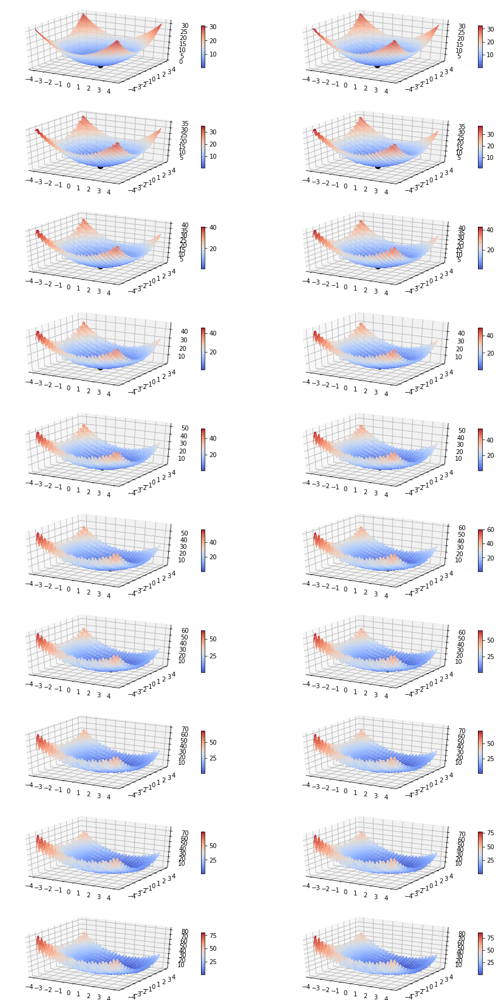

80.0


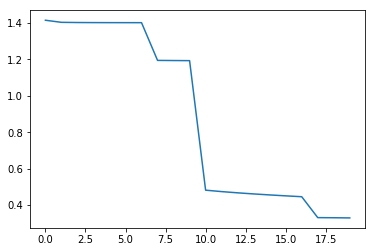

In [148]:
traj = HOM (levi, sqr, linear_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

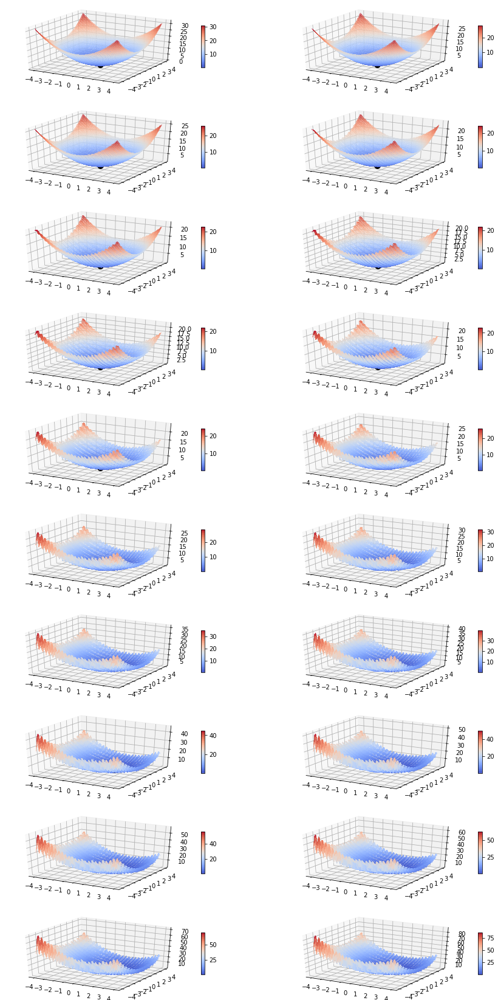

78.0
2.0539128956167945e-13


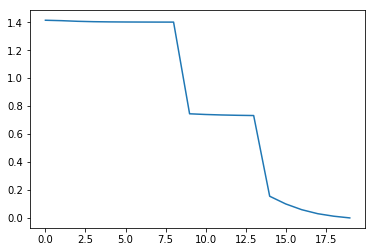

In [150]:
traj = HOM (levi, sqr, square_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])
print (traj[2][19])

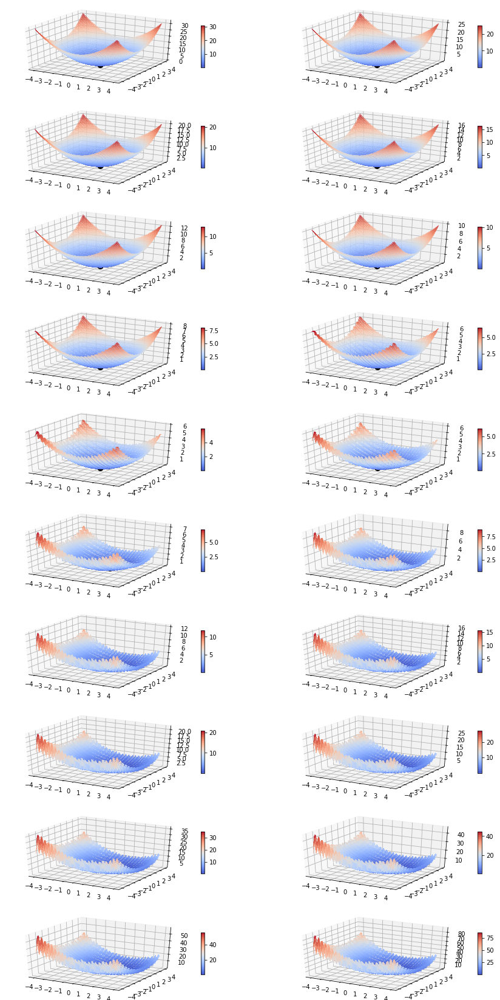

74.0
0.32961947457578467


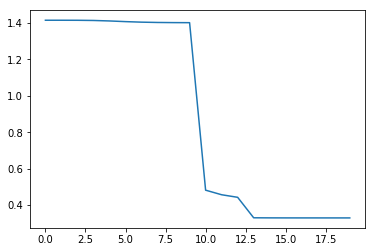

In [151]:
traj = HOM (levi, sqr, quad_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])
print (traj[2][19])

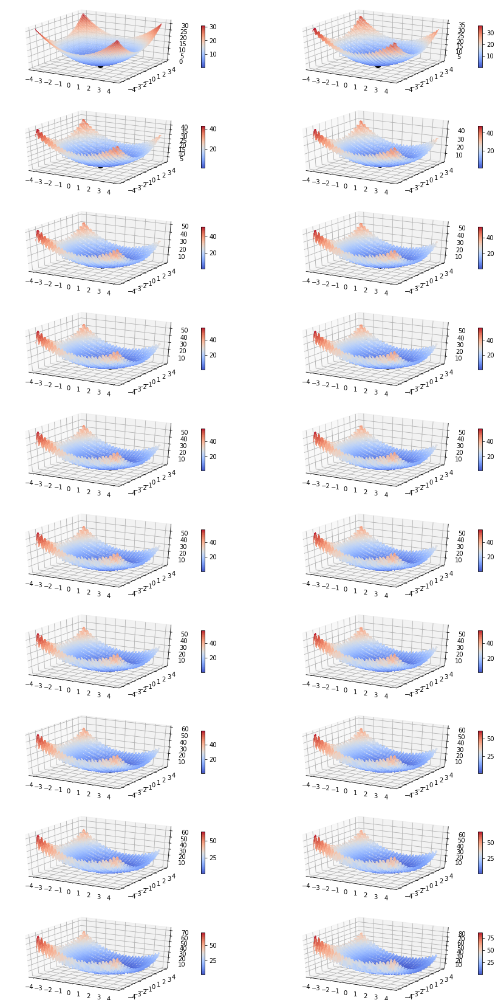

80.0
0.3296194746191039


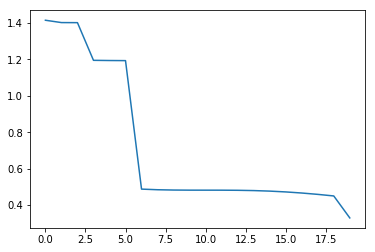

In [152]:
traj = HOM (levi, sqr, cube_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])
print (traj[2][19])

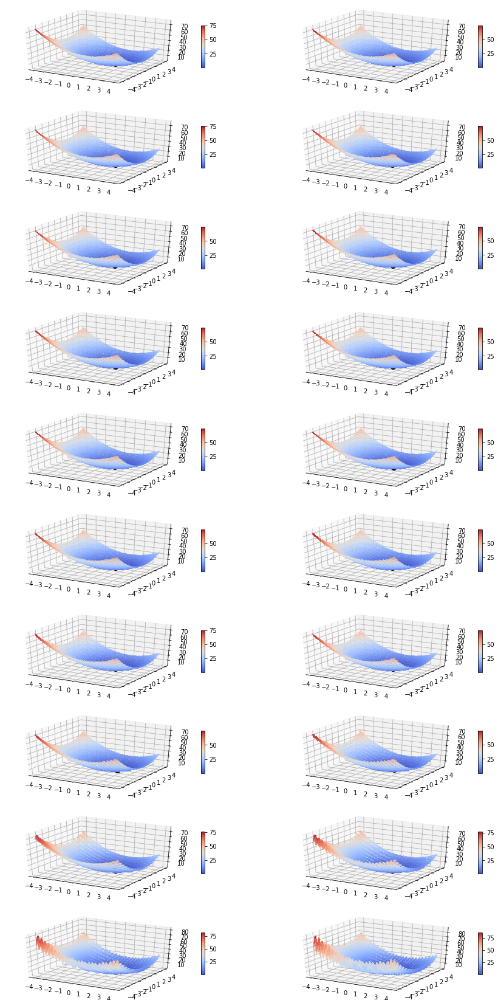

76.0
4.045652703257428e-12


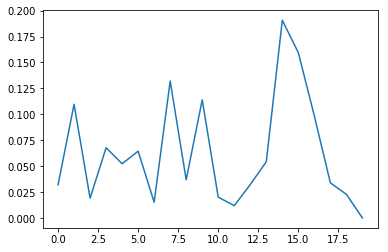

In [154]:
traj = HOM (levi, sqr, smooth_homotopy, np.zeros((2)), 20, np.ones((2)))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])
print (traj[2][19])

# HIMMELBLAU

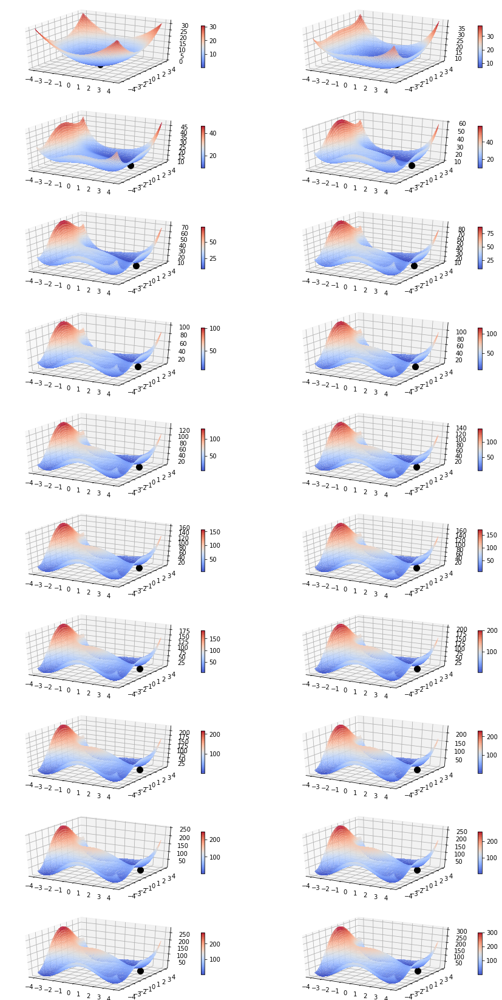

84.0


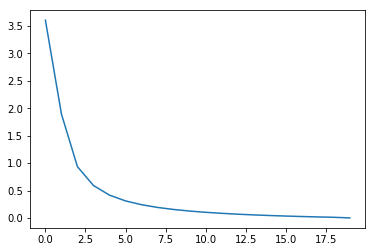

In [155]:
traj = HOM (himmelblau, sqr, linear_homotopy, np.zeros((2)), 20, np.array([3,2]))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

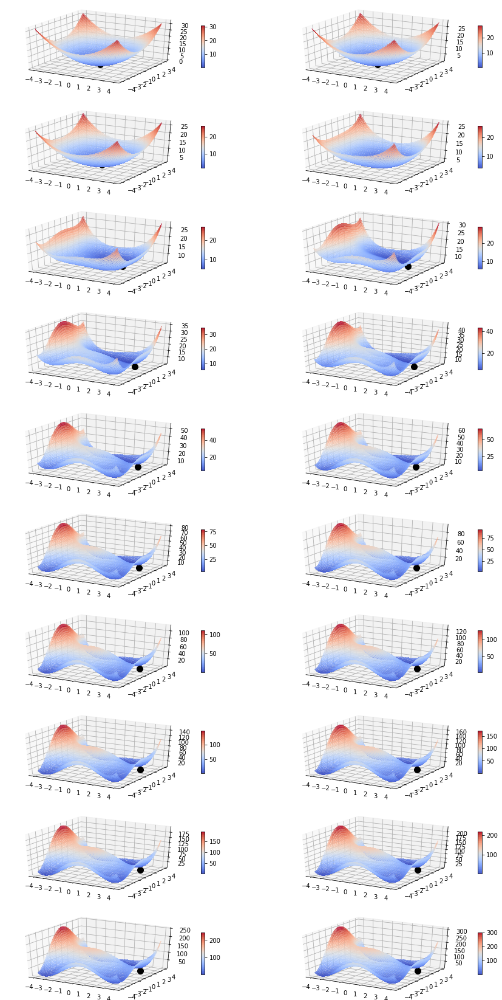

84.0


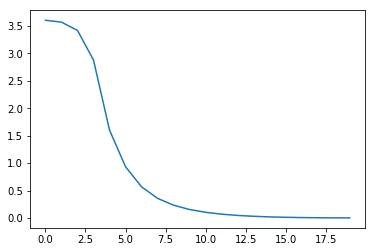

In [156]:
traj = HOM (himmelblau, sqr, square_homotopy, np.zeros((2)), 20, np.array([3,2]))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

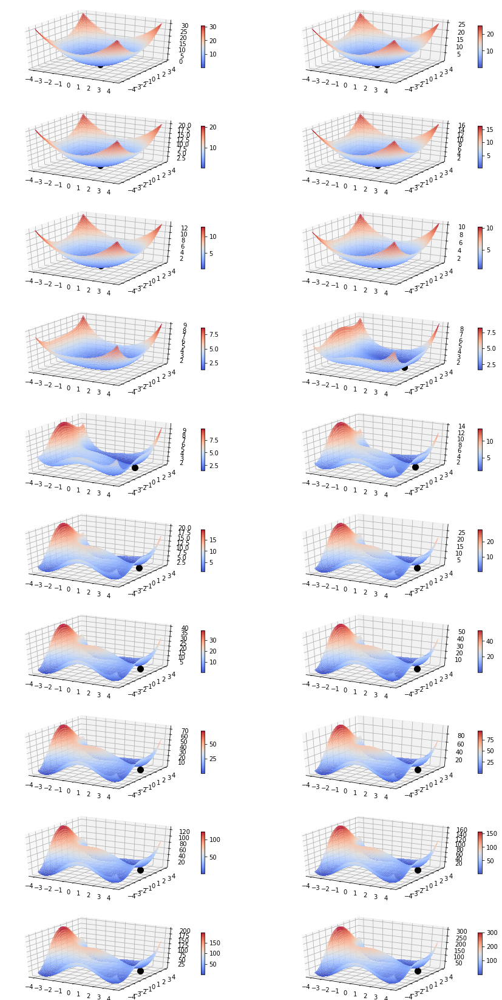

80.0


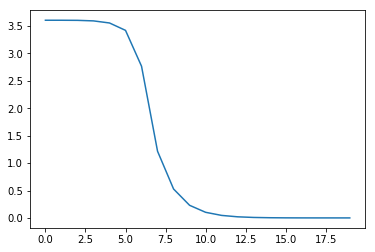

In [157]:
traj = HOM (himmelblau, sqr, quad_homotopy, np.zeros((2)), 20, np.array([3,2]))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

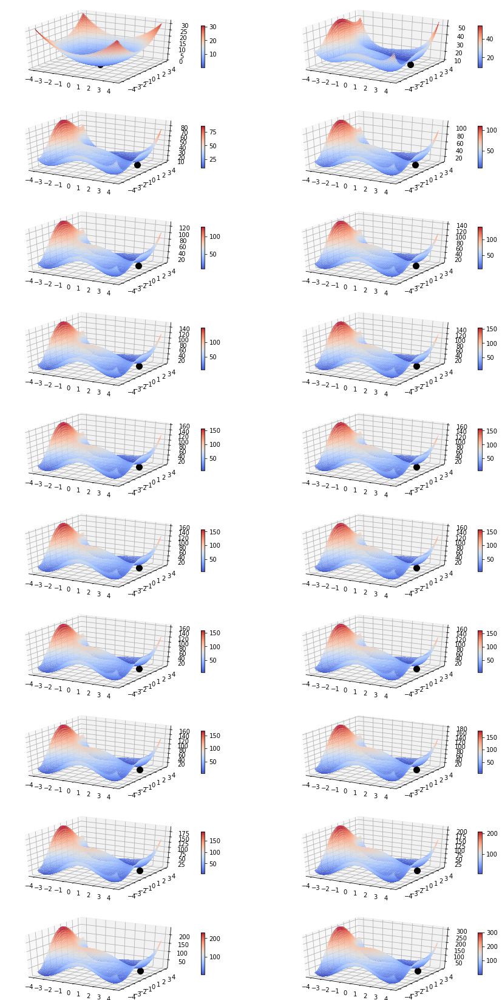

83.0


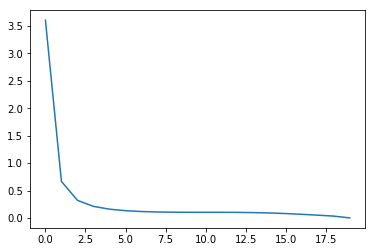

In [160]:
traj = HOM (himmelblau, sqr, cube_homotopy, np.zeros((2)), 20, np.array([3,2]))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

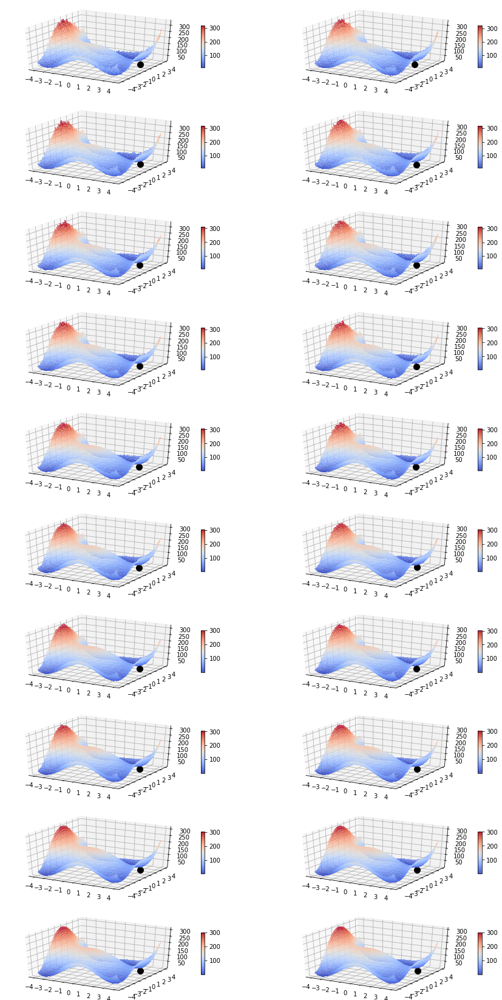

77.0


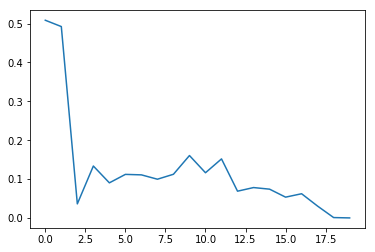

In [161]:
traj = HOM (himmelblau, sqr, smooth_homotopy, np.zeros((2)), 20, np.array([3,2]))
print (np.sum (traj[1]))
plt.plot (traj[0], traj[2])

# EASON

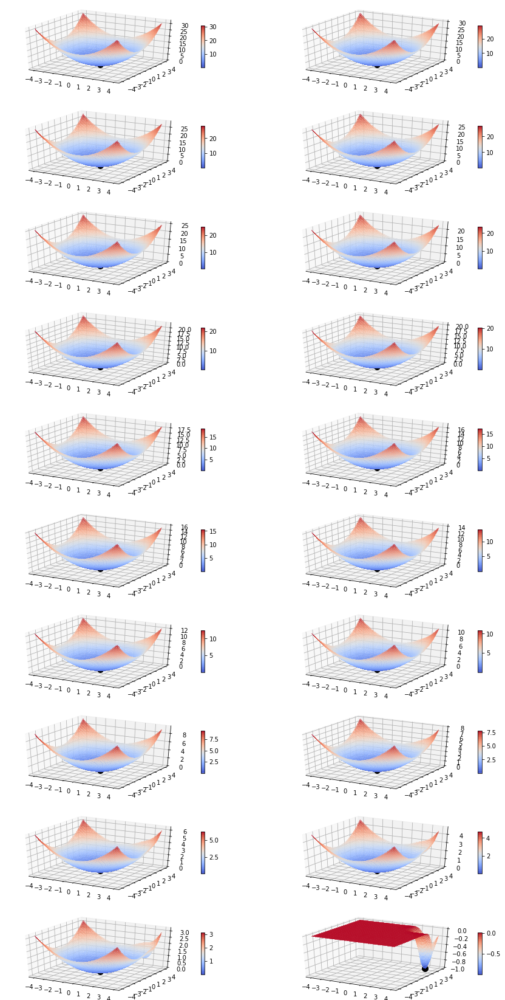

59.0
1.0735479664417382e-10


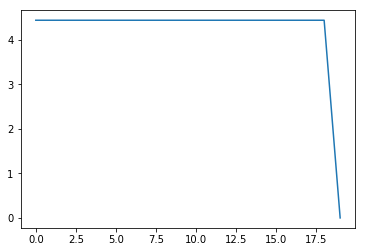

In [163]:
traj = HOM (easom, sqr, linear_homotopy, np.zeros((2)), 20, np.array([np.pi,np.pi]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])

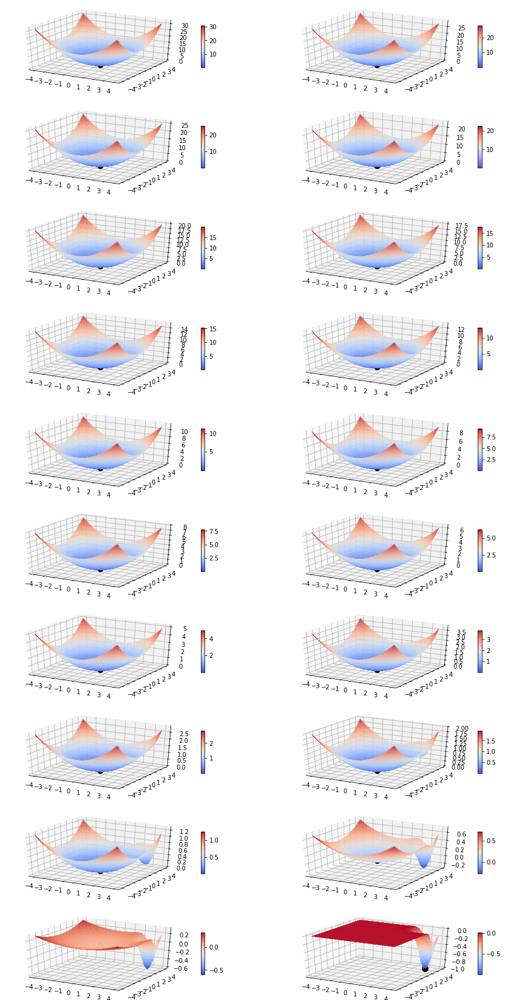

58.0
1.1014850173254912e-10


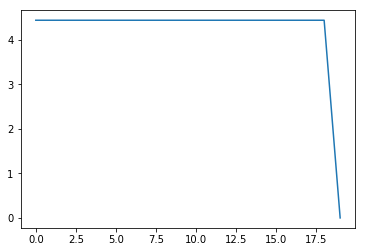

In [164]:
traj = HOM (easom, sqr, square_homotopy, np.zeros((2)), 20, np.array([np.pi,np.pi]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])

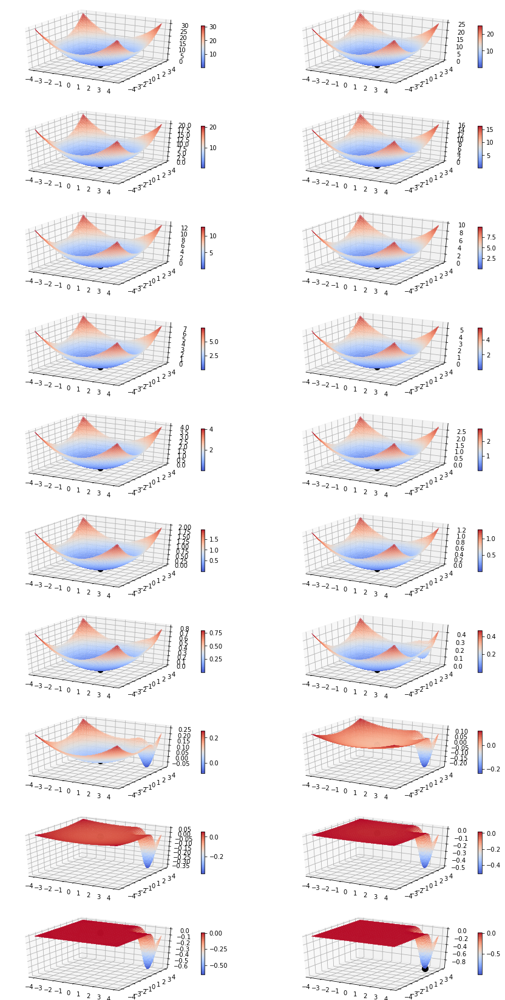

54.0
1.1089910568980131e-08


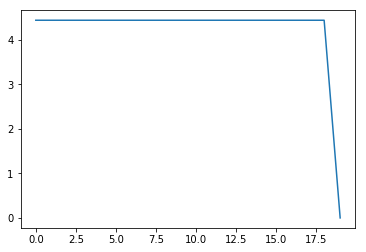

In [165]:
traj = HOM (easom, sqr, quad_homotopy, np.zeros((2)), 20, np.array([np.pi,np.pi]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])

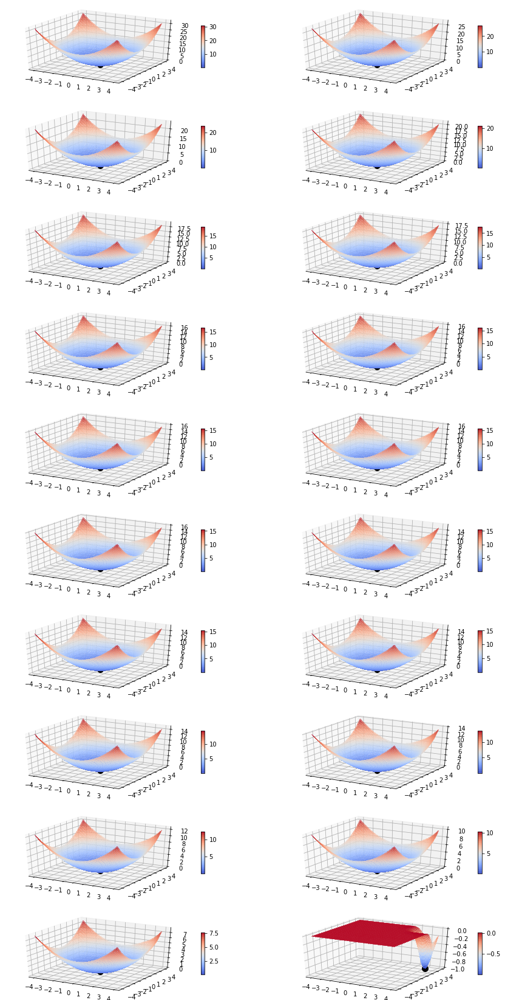

53.0
1.0778635187107172e-10


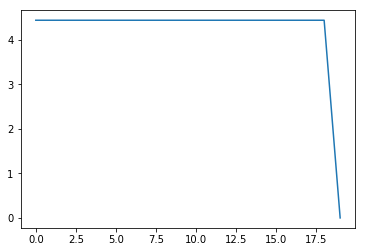

In [166]:
traj = HOM (easom, sqr, cube_homotopy, np.zeros((2)), 20, np.array([np.pi,np.pi]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])

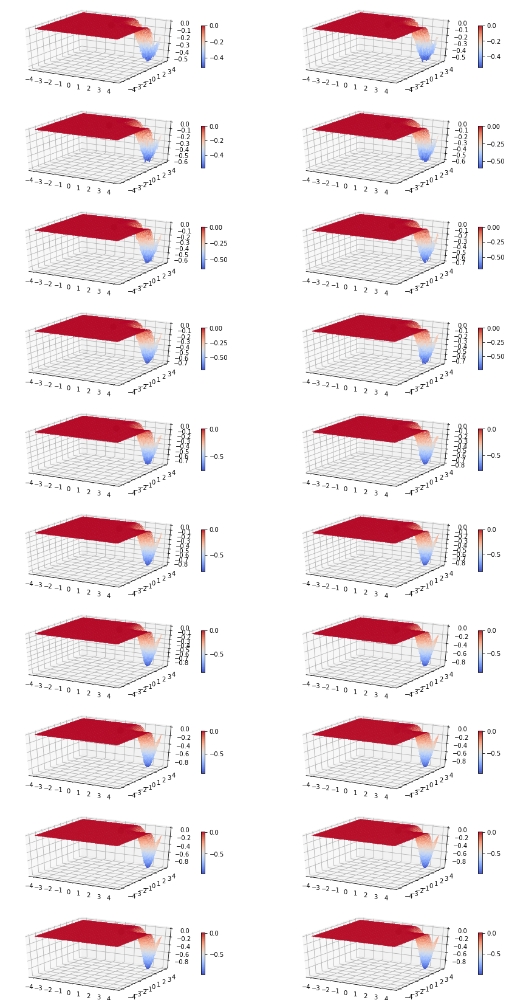

77.0
2.597340671009884


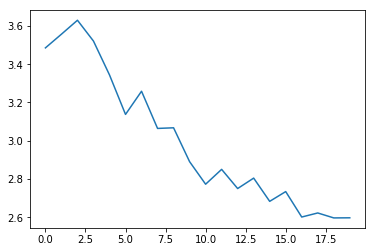

In [167]:
traj = HOM (easom, sqr, smooth_homotopy, np.zeros((2)), 20, np.array([np.pi,np.pi]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])

# CROSS

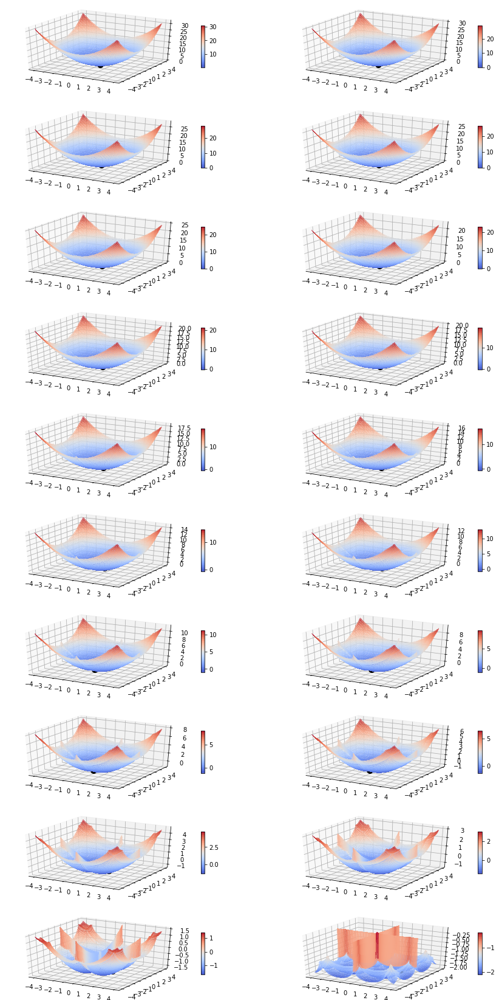

80.0
0.20296025868955095


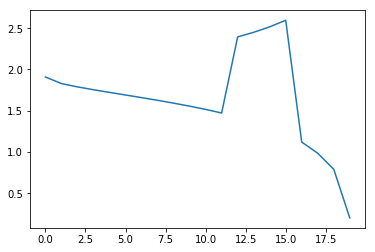

In [176]:
traj = HOM (cross, sqr, linear_homotopy, np.zeros((2)), 20, np.array([1.35, 1.35]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])

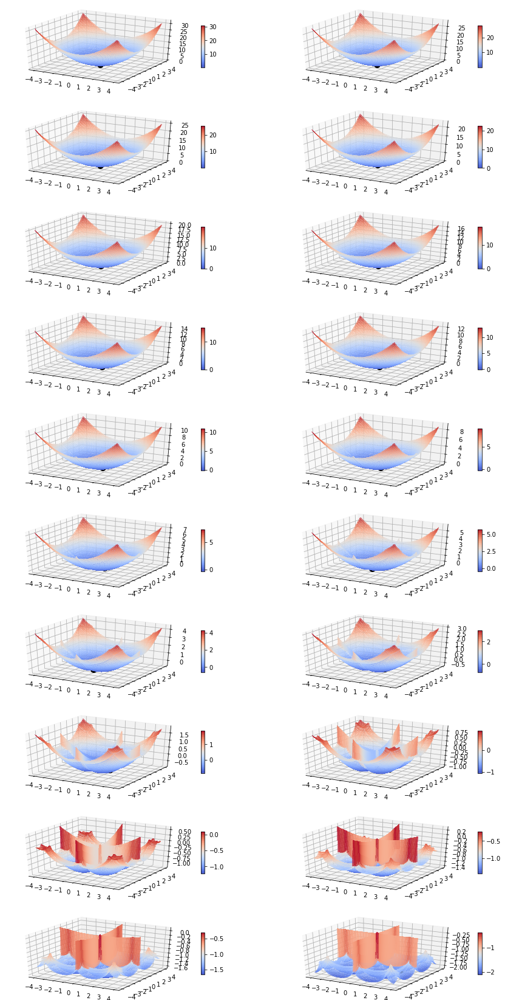

78.0
0.2029601914688633


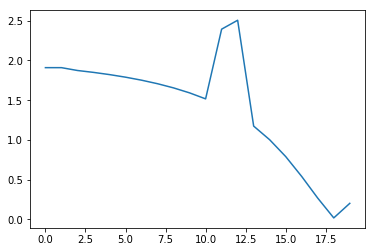

In [177]:
traj = HOM (cross, sqr, square_homotopy, np.zeros((2)), 20, np.array([1.35, 1.35]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])

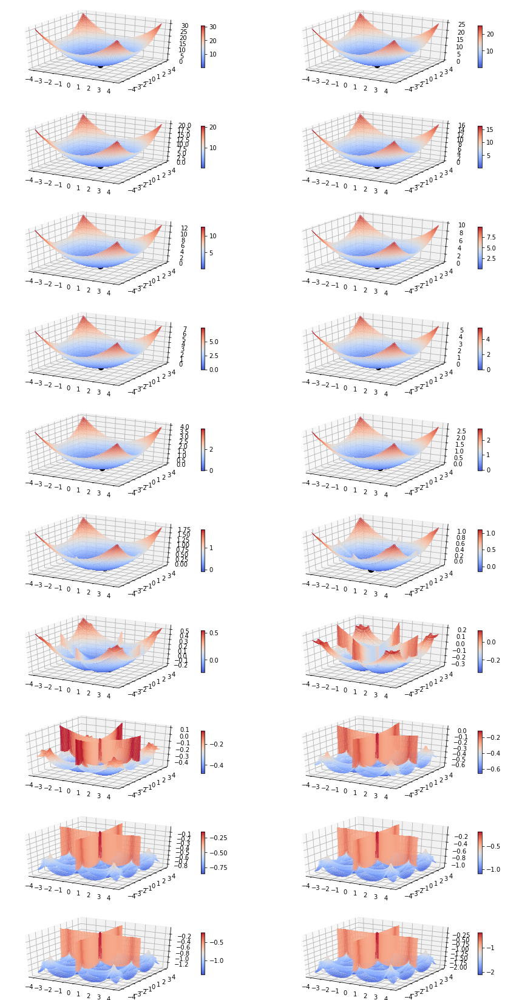

70.0
0.20296019218155156


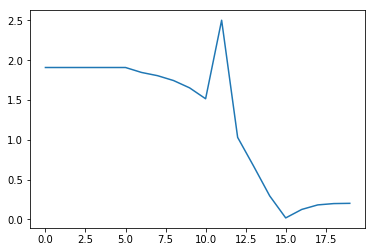

In [178]:
traj = HOM (cross, sqr, quad_homotopy, np.zeros((2)), 20, np.array([1.35, 1.35]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])

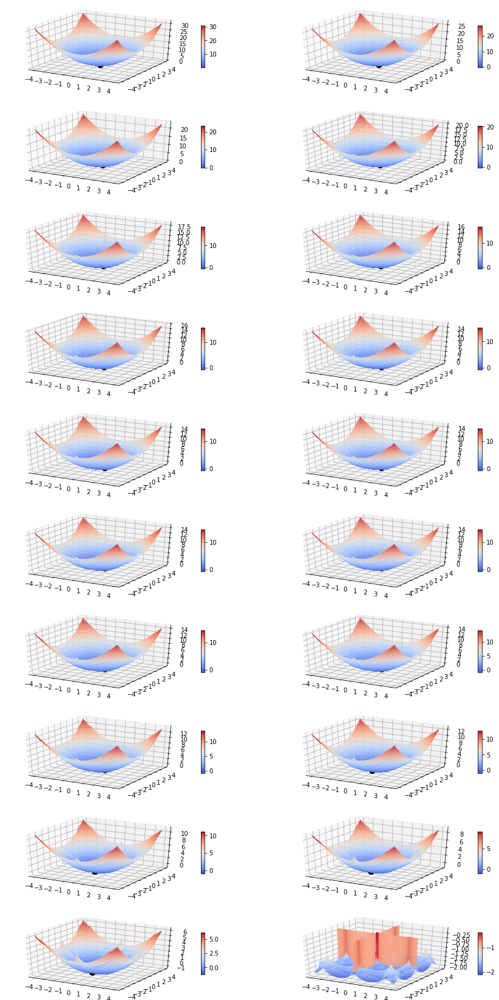

80.0
0.20296028989707654


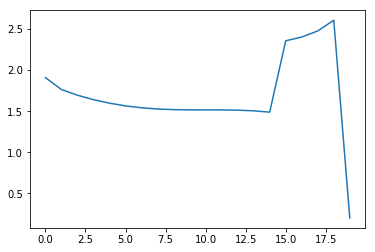

In [179]:
traj = HOM (cross, sqr, cube_homotopy, np.zeros((2)), 20, np.array([1.35, 1.35]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])

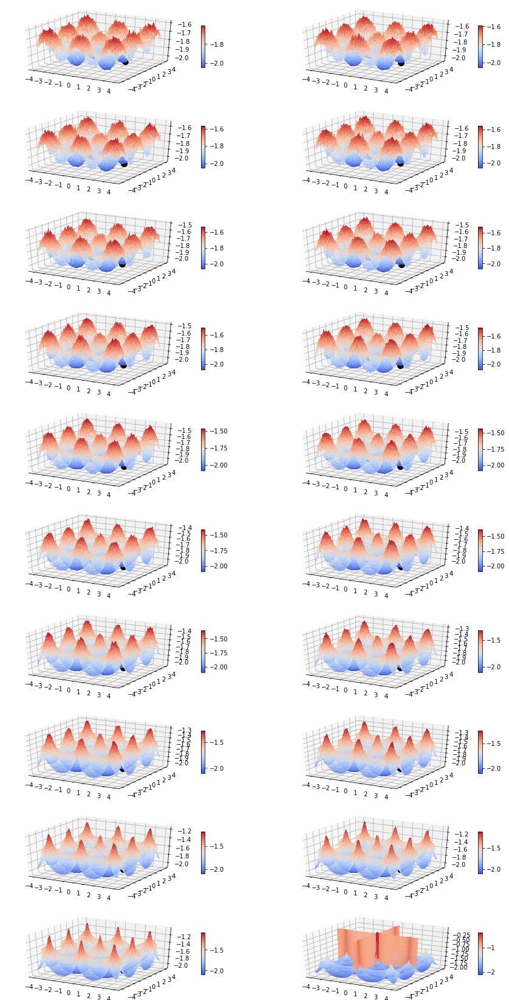

71.0
0.20296022661195048


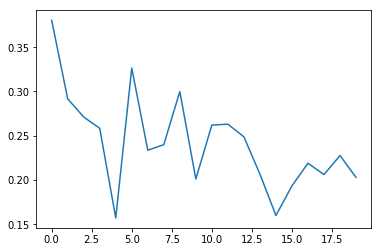

In [180]:
traj = HOM (cross, sqr, smooth_homotopy, np.zeros((2)), 20, np.array([1.35, 1.35]))
print (np.sum (traj[1]))
print (traj[2][19])
plt.plot (traj[0], traj[2])